# made by Aryan rathore (cse core student at vit bhopal)
# email :- Aryanrathore13572002@gmail.com
# linkedin :- https://www.linkedin.com/in/aryan-rathore-b15459215/
# github :- https://github.com/aryanrathore1012
# ________________________________________________________________________________

# PART 1 - PRELIMINARY AND EXPLORATORY ANALYSIS OF STATION_CSV AND STATION_DAY CSV

# objective 
<b>find meaningfull insights about AQI from diffrent stations in india. </b>

# what is AQI?

<b> The Air Quality Index (AQI) is used for reporting daily air quality. It tells you how clean or polluted your air is, and what associated health effects might be a concern for you. The AQI focuses on health effects you may experience within a few hours or days after breathing polluted air. </b>

# what does this notebook do?

<b> 

* https://www.diva-portal.org/smash/get/diva2:1681590/FULLTEXT02 in this reasearch paper the creators have only dumped the data into
thier machine learning models but did not explore the data itself. 

* in this notebook i will try my best to grab as many insights from the given data </b>

# where you can get this data?

<b> The dataset is avaible on kaggle this is the link: https://www.kaggle.com/datasets/rohanrao/air-quality-data-in-india

* city_day csv
* city_hour csv
* station_day csv
* station_hour csv

The links for geo json files of india are as follows:

* state geojson: https://github.com/Subhash9325/GeoJson-Data-of-Indian-States
* district geojson: https://www.kaggle.com/datasets/krutarthhd/india-geojson-file?select=district
</b>

# Files made in this ipynb:

<b>

* the station_merged_csv is made in this ipynb
* this csv we will futher analysed and used to train models in PART 2 of this project

</b>

# ________________________________________________________________________________

# Index
<b>

1. Imports
2. showing columns and heads of station and station_day
3. making station_mergred csv file by combining station and station_day csv files 
4. preliminary data analysis of station_merged_df  
5. exploratory data analysis of station_merged_df (the main reason why i made this notebook)

</b>

# ________________________________________________________________________________

# 1. Imports

In [1]:
# Air_Quality_Analysis_and_Prediction_for_Indian_Cities_and_States PART 1
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import datetime as dt
import seaborn as sns
import geopandas as gpd
import folium
%matplotlib inline

# ________________________________________________________________________________
# 2. showing columns and heads of station and station_day

In [2]:
station_df = pd.read_csv("F://aryans_code_notes//machine_learning//AQI_predictior//stations.csv") 
station_day_df = pd.read_csv("F://aryans_code_notes//machine_learning//AQI_predictior//station_day.csv") 

In [3]:
station_df

,StationId,StationName,City,State,Status
0,AP001,"Secretariat, Amaravati - APPCB",Amaravati,Andhra Pradesh,Active
1,AP002,"Anand Kala Kshetram, Rajamahendravaram - APPCB",Rajamahendravaram,Andhra Pradesh,NaN
2,AP003,"Tirumala, Tirupati - APPCB",Tirupati,Andhra Pradesh,NaN
3,AP004,"PWD Grounds, Vijayawada - APPCB",Vijayawada,Andhra Pradesh,NaN
4,AP005,"GVM Corporation, Visakhapatnam - APPCB",Visakhapatnam,Andhra Pradesh,Active
...,...,...,...,...,...
225,WB010,"Jadavpur, Kolkata - WBPCB",Kolkata,West Bengal,Active
226,WB011,"Rabindra Bharati University, Kolkata - WBPCB",Kolkata,West Bengal,Active
227,WB012,"Rabindra Sarobar, Kolkata - WBPCB",Kolkata,West Bengal,Active
228,WB013,"Victoria, Kolkata - WBPCB",Kolkata,West Bengal,Active


In [4]:
station_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 230 entries, 0 to 229
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   StationId    230 non-null    object
 1   StationName  230 non-null    object
 2   City         230 non-null    object
 3   State        230 non-null    object
 4   Status       133 non-null    object
dtypes: object(5)
memory usage: 9.1+ KB


In [5]:
station_df.shape

(230, 5)

In [6]:
station_day_df

,StationId,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,AP001,2017-11-24,71.36,115.75,1.75,20.65,12.40,12.19,0.10,10.76,109.26,0.17,5.92,0.10,NaN,NaN
1,AP001,2017-11-25,81.40,124.50,1.44,20.50,12.08,10.72,0.12,15.24,127.09,0.20,6.50,0.06,184.0,Moderate
2,AP001,2017-11-26,78.32,129.06,1.26,26.00,14.85,10.28,0.14,26.96,117.44,0.22,7.95,0.08,197.0,Moderate
3,AP001,2017-11-27,88.76,135.32,6.60,30.85,21.77,12.91,0.11,33.59,111.81,0.29,7.63,0.12,198.0,Moderate
4,AP001,2017-11-28,64.18,104.09,2.56,28.07,17.01,11.42,0.09,19.00,138.18,0.17,5.02,0.07,188.0,Moderate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108030,WB013,2020-06-27,8.65,16.46,NaN,NaN,NaN,NaN,0.69,4.36,30.59,1.32,7.26,NaN,50.0,Good
108031,WB013,2020-06-28,11.80,18.47,NaN,NaN,NaN,NaN,0.68,3.49,38.95,1.42,7.92,NaN,65.0,Satisfactory
108032,WB013,2020-06-29,18.60,32.26,13.65,200.87,214.20,11.40,0.78,5.12,38.17,3.52,8.64,NaN,63.0,Satisfactory
108033,WB013,2020-06-30,16.07,39.30,7.56,29.13,36.69,29.26,0.69,5.88,29.64,1.86,8.40,NaN,57.0,Satisfactory


In [7]:
station_day_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 108035 entries, 0 to 108034
Data columns (total 16 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   StationId   108035 non-null  object 
 1   Date        108035 non-null  object 
 2   PM2.5       86410 non-null   float64
 3   PM10        65329 non-null   float64
 4   NO          90929 non-null   float64
 5   NO2         91488 non-null   float64
 6   NOx         92535 non-null   float64
 7   NH3         59930 non-null   float64
 8   CO          95037 non-null   float64
 9   SO2         82831 non-null   float64
 10  O3          82467 non-null   float64
 11  Benzene     76580 non-null   float64
 12  Toluene     69333 non-null   float64
 13  Xylene      22898 non-null   float64
 14  AQI         87025 non-null   float64
 15  AQI_Bucket  87025 non-null   object 
dtypes: float64(13), object(3)
memory usage: 13.2+ MB


In [8]:
station_day_df.shape

(108035, 16)


# ________________________________________________________________________________
# 3. making the station merged csv (main csv we will work with)

In [9]:
# we will join the datasets as it makes analysing the data easier

# we dont need the name of the station and the satus if it is active or not so dropping these columns

station_df = station_df.drop(columns=["StationName","Status"])

station_df

,StationId,City,State
0,AP001,Amaravati,Andhra Pradesh
1,AP002,Rajamahendravaram,Andhra Pradesh
2,AP003,Tirupati,Andhra Pradesh
3,AP004,Vijayawada,Andhra Pradesh
4,AP005,Visakhapatnam,Andhra Pradesh
...,...,...,...
225,WB010,Kolkata,West Bengal
226,WB011,Kolkata,West Bengal
227,WB012,Kolkata,West Bengal
228,WB013,Kolkata,West Bengal


In [12]:
station_merged_df = pd.merge(station_df, station_day_df, on="StationId")


# ________________________________________________________________________________
# 4. preliminary data analysis of station_merged_df  

checking if the station_merged_df  
1. general shape 
2. some values
3. columns
4. data distribution
5. has any missing values
6. dealing with missing values

In [13]:
# 1. general shape
station_merged_df.shape

(108035, 18)

In [14]:
# 2. some values
station_merged_df

,StationId,City,State,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,AP001,Amaravati,Andhra Pradesh,2017-11-24,71.36,115.75,1.75,20.65,12.40,12.19,0.10,10.76,109.26,0.17,5.92,0.10,NaN,NaN
1,AP001,Amaravati,Andhra Pradesh,2017-11-25,81.40,124.50,1.44,20.50,12.08,10.72,0.12,15.24,127.09,0.20,6.50,0.06,184.0,Moderate
2,AP001,Amaravati,Andhra Pradesh,2017-11-26,78.32,129.06,1.26,26.00,14.85,10.28,0.14,26.96,117.44,0.22,7.95,0.08,197.0,Moderate
3,AP001,Amaravati,Andhra Pradesh,2017-11-27,88.76,135.32,6.60,30.85,21.77,12.91,0.11,33.59,111.81,0.29,7.63,0.12,198.0,Moderate
4,AP001,Amaravati,Andhra Pradesh,2017-11-28,64.18,104.09,2.56,28.07,17.01,11.42,0.09,19.00,138.18,0.17,5.02,0.07,188.0,Moderate
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108030,WB013,Kolkata,West Bengal,2020-06-27,8.65,16.46,NaN,NaN,NaN,NaN,0.69,4.36,30.59,1.32,7.26,NaN,50.0,Good
108031,WB013,Kolkata,West Bengal,2020-06-28,11.80,18.47,NaN,NaN,NaN,NaN,0.68,3.49,38.95,1.42,7.92,NaN,65.0,Satisfactory
108032,WB013,Kolkata,West Bengal,2020-06-29,18.60,32.26,13.65,200.87,214.20,11.40,0.78,5.12,38.17,3.52,8.64,NaN,63.0,Satisfactory
108033,WB013,Kolkata,West Bengal,2020-06-30,16.07,39.30,7.56,29.13,36.69,29.26,0.69,5.88,29.64,1.86,8.40,NaN,57.0,Satisfactory


In [15]:
# 3. columns

station_merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108035 entries, 0 to 108034
Data columns (total 18 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   StationId   108035 non-null  object 
 1   City        108035 non-null  object 
 2   State       108035 non-null  object 
 3   Date        108035 non-null  object 
 4   PM2.5       86410 non-null   float64
 5   PM10        65329 non-null   float64
 6   NO          90929 non-null   float64
 7   NO2         91488 non-null   float64
 8   NOx         92535 non-null   float64
 9   NH3         59930 non-null   float64
 10  CO          95037 non-null   float64
 11  SO2         82831 non-null   float64
 12  O3          82467 non-null   float64
 13  Benzene     76580 non-null   float64
 14  Toluene     69333 non-null   float64
 15  Xylene      22898 non-null   float64
 16  AQI         87025 non-null   float64
 17  AQI_Bucket  87025 non-null   object 
dtypes: float64(13), object(5)
memory usage: 15.7

In [16]:
# 4 data distribution

station_merged_df.describe()

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
count,86410.000000,65329.000000,90929.000000,91488.000000,92535.000000,59930.000000,95037.000000,82831.000000,82467.000000,76580.000000,69333.000000,22898.000000,87025.000000
mean,80.272571,157.968427,23.123424,35.240760,41.195055,28.732875,1.605749,12.257634,38.134836,3.358029,15.345394,2.423446,179.749290
std,76.526403,123.418672,34.491019,29.510827,45.145976,24.897797,4.369578,12.984723,39.128004,11.156234,29.348587,6.472409,131.324339
min,0.020000,0.010000,0.010000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,8.000000
25%,31.880000,70.150000,4.840000,15.090000,13.970000,11.900000,0.530000,5.040000,18.895000,0.160000,0.690000,0.000000,86.000000
50%,55.950000,122.090000,10.290000,27.210000,26.660000,23.590000,0.910000,8.950000,30.840000,1.210000,4.330000,0.400000,132.000000
75%,99.920000,208.670000,24.980000,46.930000,50.500000,38.137500,1.450000,14.920000,47.140000,3.610000,17.510000,2.110000,254.000000
max,1000.000000,1000.000000,470.000000,448.050000,467.630000,418.900000,175.810000,195.650000,963.000000,455.030000,454.850000,170.370000,2049.000000


![aqi thresholds](https://user-images.githubusercontent.com/91218998/226107225-4e78b162-7844-43d9-88c4-17caf21f76da.png)

### From the above table we see that over the years from 2015 to 2020 the air has been moderately polluted 

In [17]:
station_merged_df.isnull().sum()

StationId         0
City              0
State             0
Date              0
PM2.5         21625
PM10          42706
NO            17106
NO2           16547
NOx           15500
NH3           48105
CO            12998
SO2           25204
O3            25568
Benzene       31455
Toluene       38702
Xylene        85137
AQI           21010
AQI_Bucket    21010
dtype: int64

* there are 21010 rows in the dataset where AQI, and AQI_Bucket are missing
* these rows are useless as they dont have our target value so we will remove them

In [18]:
# we will only selecting values where isnull is not true (meaning the value is not null)

mask = station_merged_df["AQI"].isnull() == False
station_merged_df = station_merged_df[mask]

In [19]:
station_merged_df.isnull().sum()

StationId         0
City              0
State             0
Date              0
PM2.5          3488
PM10          23961
NO             2229
NO2            1566
NOx            4555
NH3           29832
CO             2896
SO2            9533
O3             9598
Benzene       19787
Toluene       26324
Xylene        67584
AQI               0
AQI_Bucket        0
dtype: int64

* the missing values now are  are numerical columns 
* the best way fill those values would be to replace these values with the mean of the column

In [20]:
station_merged_df.describe().loc["mean"]

PM2.5       80.387649
PM10       158.557614
NO          23.244401
NO2         35.118825
NOx         43.246664
NH3         28.654163
CO           1.615741
SO2         12.212651
O3          38.320547
Benzene      3.566688
Toluene     16.557039
Xylene       2.770696
AQI        179.749290
Name: mean, dtype: float64

In [21]:
station_merged_df = station_merged_df.replace({

"PM2.5" : {np.nan:80.387649},
"PM10" :{np.nan:158.557614},
"NO": {np.nan:23.244401},
"NO2": {np.nan:35.118825},
"NOx": {np.nan:43.246664},
"NH3": {np.nan:28.654163},
"CO":  {np.nan:1.615741},
"SO2": {np.nan:12.212651},
"O3": {np.nan:38.320547},
"Benzene":  {np.nan:3.566688},
"Toluene": {np.nan:16.557039},
"Xylene":  {np.nan:2.770696}})
station_merged_df.isnull().sum()

StationId     0
City          0
State         0
Date          0
PM2.5         0
PM10          0
NO            0
NO2           0
NOx           0
NH3           0
CO            0
SO2           0
O3            0
Benzene       0
Toluene       0
Xylene        0
AQI           0
AQI_Bucket    0
dtype: int64

In [22]:
# the same thing can be done in this way as well
# this is the imputing method

# from sklearn.impute import SimpleImputer

# imputer = SimpleImputer(missing_values=np.nan, strategy="mean")

# columns_to_impute = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene']

# station_merged_df['PM2.5'] = imputer.fit_transform(station_merged_df[["PM2.5"]])
# station_merged_df['PM10'] = imputer.fit_transform(station_merged_df[["PM10"]])
# station_merged_df['NO'] = imputer.fit_transform(station_merged_df[["NO"]])
# station_merged_df['NO2'] = imputer.fit_transform(station_merged_df[["NO2"]])
# station_merged_df['NOx'] = imputer.fit_transform(station_merged_df[["NOx"]])
# station_merged_df['NH3'] = imputer.fit_transform(station_merged_df[["NH3"]])
# station_merged_df['CO'] = imputer.fit_transform(station_merged_df[["CO"]])
# station_merged_df['SO2'] = imputer.fit_transform(station_merged_df[["SO2"]])
# station_merged_df['O3'] = imputer.fit_transform(station_merged_df[["O3"]])
# station_merged_df['Benzene'] = imputer.fit_transform(station_merged_df[["Benzene"]])
# station_merged_df['Toluene'] = imputer.fit_transform(station_merged_df[["Toluene"]])
# station_merged_df['Xylene'] = imputer.fit_transform(station_merged_df[["Xylene"]])

# station_merged_df.isnull().sum()


### The lines below change date column datetime pandas datatype and 3 creates columns (year, month, day) then drops the date column

In [23]:
station_merged_df["Date"] = pd.to_datetime(station_merged_df["Date"])
station_merged_df["year"] = station_merged_df["Date"].dt.year
station_merged_df["month"] = station_merged_df["Date"].dt.month
station_merged_df["day"] = station_merged_df["Date"].dt.day
station_merged_df.drop('Date',axis=1,inplace=True)

<b> This is what our station_merged_df looks like after preliminary data analysis </b>

In [24]:
station_merged_df.shape

(87025, 20)

In [25]:
station_merged_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 87025 entries, 1 to 108034
Data columns (total 20 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   StationId   87025 non-null  object 
 1   City        87025 non-null  object 
 2   State       87025 non-null  object 
 3   PM2.5       87025 non-null  float64
 4   PM10        87025 non-null  float64
 5   NO          87025 non-null  float64
 6   NO2         87025 non-null  float64
 7   NOx         87025 non-null  float64
 8   NH3         87025 non-null  float64
 9   CO          87025 non-null  float64
 10  SO2         87025 non-null  float64
 11  O3          87025 non-null  float64
 12  Benzene     87025 non-null  float64
 13  Toluene     87025 non-null  float64
 14  Xylene      87025 non-null  float64
 15  AQI         87025 non-null  float64
 16  AQI_Bucket  87025 non-null  object 
 17  year        87025 non-null  int64  
 18  month       87025 non-null  int64  
 19  day         87025 non-nu

### in station merged df

| #  | Column     | Non-Null Count  | Dtype   |    meaning   |
|:-: | :------:     | :--------------:  | :-----:   | :---:  |
| 0  | StationId  | 108035 non-null | object  |    id of the station   |
| 1  | City       | 108035 non-null | object  |    city in which the station is located   |
| 2  | State      | 108035 non-null | object  |    state in which the station is located   |
| _  | Date       | 108035 non-null | object  |    date of the readings (now removed)   |
| 3  | PM2.5      | 86410 non-null  | float64 |    amount of said checmical in the air   |
| 4  | PM10       | 65329 non-null  | float64 |    amount of said checmical in the air   |
| 5  | NO         | 90929 non-null  | float64 |    amount of said checmical in the air   |
| 6  | NO2        | 91488 non-null  | float64 |    amount of said checmical in the air   |
| 7  | NOx        | 92535 non-null  | float64 |    amount of said checmical in the air   |
| 8  | NH3        | 59930 non-null  | float64 |    amount of said checmical in the air   |
| 9  | CO         | 95037 non-null  | float64 |    amount of said checmical in the air   |
| 10 | SO2        | 82831 non-null  | float64 |    amount of said checmical in the air   |
| 11 | O3         | 82467 non-null  | float64 |    amount of said checmical in the air   |
| 12 | Benzene    | 76580 non-null  | float64 |    amount of said checmical in the air   |
| 13 | Toluene    | 69333 non-null  | float64 |    amount of said checmical in the air   |
| 14 | Xylene     | 22898 non-null  | float64 |    amount of said checmical in the air   |
| 15 | AQI        | 87025 non-null  | float64 |    the air quality that day   |
| 16 | AQI_Bucket | 87025 non-null  | object  |    AQI catagory ranges from good to severe   |
| 17 | year       | 87025 non-null  | float64 |    year of the reading   |
| 18 | month      | 87025 non-null  | float64 |    month of the reading   |
| 18 | date       | 87025 non-null  | float64 |    day of the reading   |

In [26]:
station_merged_df

,StationId,City,State,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket,year,month,day
1,AP001,Amaravati,Andhra Pradesh,81.40,124.50,1.440000,20.500000,12.080000,10.720000,0.12,15.24,127.09,0.20,6.50,0.060000,184.0,Moderate,2017,11,25
2,AP001,Amaravati,Andhra Pradesh,78.32,129.06,1.260000,26.000000,14.850000,10.280000,0.14,26.96,117.44,0.22,7.95,0.080000,197.0,Moderate,2017,11,26
3,AP001,Amaravati,Andhra Pradesh,88.76,135.32,6.600000,30.850000,21.770000,12.910000,0.11,33.59,111.81,0.29,7.63,0.120000,198.0,Moderate,2017,11,27
4,AP001,Amaravati,Andhra Pradesh,64.18,104.09,2.560000,28.070000,17.010000,11.420000,0.09,19.00,138.18,0.17,5.02,0.070000,188.0,Moderate,2017,11,28
5,AP001,Amaravati,Andhra Pradesh,72.47,114.84,5.230000,23.200000,16.590000,12.250000,0.16,10.55,109.74,0.21,4.71,0.080000,173.0,Moderate,2017,11,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
108030,WB013,Kolkata,West Bengal,8.65,16.46,23.244401,35.118825,43.246664,28.654163,0.69,4.36,30.59,1.32,7.26,2.770696,50.0,Good,2020,6,27
108031,WB013,Kolkata,West Bengal,11.80,18.47,23.244401,35.118825,43.246664,28.654163,0.68,3.49,38.95,1.42,7.92,2.770696,65.0,Satisfactory,2020,6,28
108032,WB013,Kolkata,West Bengal,18.60,32.26,13.650000,200.870000,214.200000,11.400000,0.78,5.12,38.17,3.52,8.64,2.770696,63.0,Satisfactory,2020,6,29
108033,WB013,Kolkata,West Bengal,16.07,39.30,7.560000,29.130000,36.690000,29.260000,0.69,5.88,29.64,1.86,8.40,2.770696,57.0,Satisfactory,2020,6,30


In [27]:
# writing the csv back
station_merged_df.to_csv("F://aryans_code_notes//machine_learning//AQI_predictior//station_merged.csv", index=False)

### things changed in station_merged_csv

* dropped all columns where aqi reading was none
* numerical missing values were replaced with means of the respective columns 
* dropped the date column and added day, month, year columns instead

### this is it for the preliminary analysis of station_merged_df now the fun part

# ________________________________________________________________________________

# 5. exploratory data analysis of station_merged_df (the main reason why i made this notebook)

1. trend of aqi throughout the years 
2. aqi trend of states in india 
3. aqi trend of cities in india
4. yearly/ monthly state_Aqi_from_2015_to_2020 function
5. yearly/ monthly city_Aqi_from_2015_to_2020 function
6. correlation of toxic gasses with aqi (top 3)
7. yearly/monthly state_toxic_gas_from_2015_2020 india function
8. yearly/monthly city_toxic_gas_from_2015_2020 india function
9. aqi of states on an india map
10. aqi of cities on an india map



### First lets see aqi trends from 2015-2020

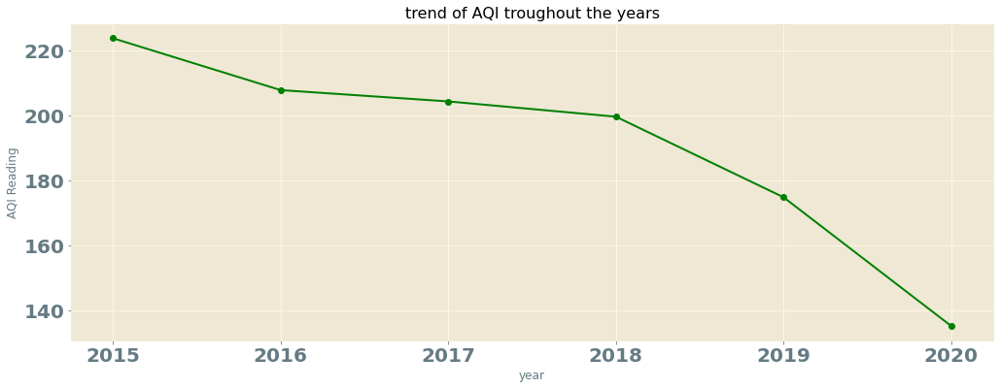

In [28]:
# -------------------------------------------------------------------------------------------------------------------
# 1. trend of aqi throughout the years 

plt.figure(figsize=(17,6))

font = {'family' : 'DejaVu Sans',
        'weight' : 'bold',
        'size'   : 20}

mpl.rc('font', **font)

mpl.style.use("Solarize_Light2")
yearly_grouped = station_merged_df.groupby("year")["AQI"].mean().plot(kind="line",c="green", marker="o",title="trend of AQI troughout the years", ylabel="AQI Reading")


* the AQI has decreased steadily over the years esepecially from 2018
* the reason 2020 has such a low aqi is due to covid 19 lockdowns  
* you can read this news article https://blogs.worldbank.org/endpovertyinsouthasia/india-air-quality-has-been-improving-despite-covid-19-lockdown


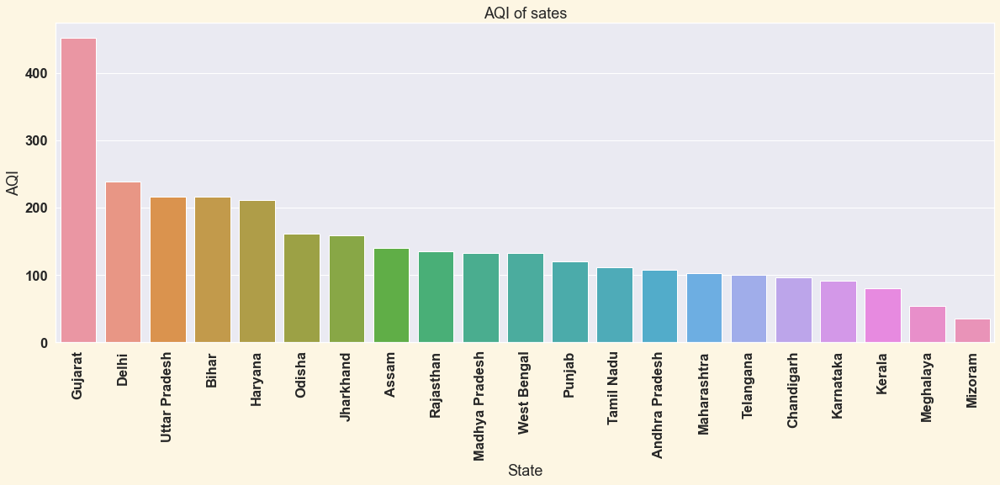

In [29]:
# -------------------------------------------------------------------------------------------------------------------
# 2. aqi trend of states in india

states_group = pd.DataFrame(station_merged_df.groupby("State")["AQI"].mean()).reset_index()
states_group = states_group.sort_values(by="AQI", ascending=False)
plt.figure(figsize=(20,7))
sns.set(font_scale=1.5)
sns.barplot(x='State', y='AQI', data=states_group).set(title ='AQI of sates')
plt.xticks(rotation=90)
plt.show()

* Gujrat has the most toxic air with aqi catagory of "Severe" even surpassing delhi
* Mizoram has the freshest air with an aqi of under 100

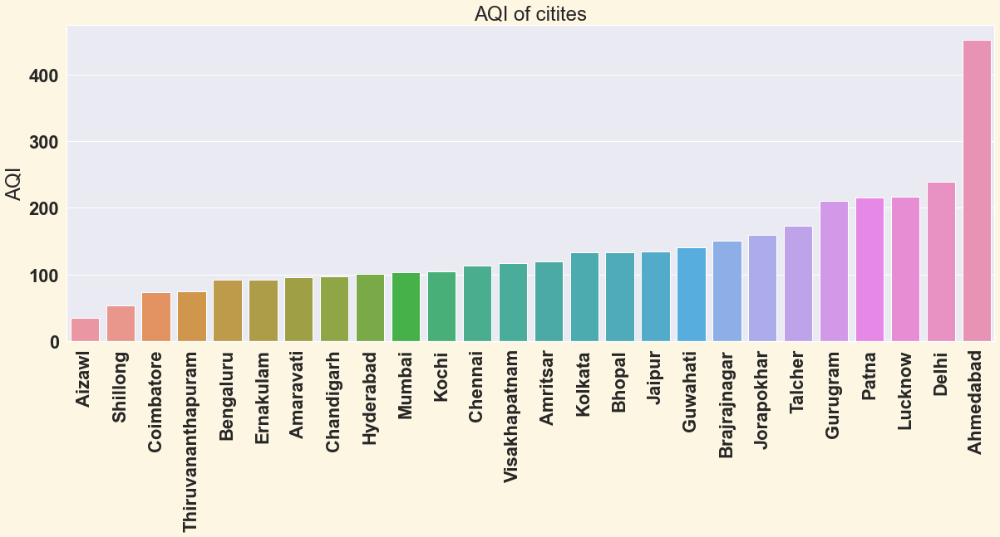

In [30]:
# -------------------------------------------------------------------------------------------------------------------
# 3. aqi trend of cities in india

cities_group = pd.DataFrame(station_merged_df.groupby("City")["AQI"].mean()).reset_index()
cities_group = cities_group.sort_values(by="AQI", ascending=True)
mpl.style.use("Solarize_Light2")
plt.figure(figsize=(20,7))
sns.set(font_scale=2)
sns.barplot(x="City", y="AQI", data=cities_group).set(title="AQI of citites", xlabel="", ylabel="AQI")
plt.xticks(rotation=90)
plt.show()

* the aqi of Aizawl is the best (0-100) healthy
* the the other hand Ahemdabad is worst with the avrage aqi reaching (400+) severe

In [31]:

# -------------------------------------------------------------------------------------------------------------------
# 4. Yearly/ monthly state_Aqi_from_2015_to_2020 function

def state_Aqi_from_2015_to_2020(required_state, year_or_month): # 1, 2

    '''
        This function shows the aqi trend of a state from 2016 to 2020 on a yearly or monthly basis

        steps:
        1. checks if year_or_month is 0 or 1 on these basis it shows the monthly aqi trend or yearly aqi trend
        2. gets the required state from the user
        3. makes mask and then makes required_state_df
        4. if 0 years_group is the mean() of all aqi readings from 2016 to 2020 else its all months from 2016 to 2020
        5. makes the bar/line plot
    '''

    if year_or_month == 0: # yearly aqi report

        required_state_mask = station_merged_df["State"] == required_state # 3
        required_state_df = station_merged_df[required_state_mask] # 3
        years_group = pd.DataFrame(required_state_df.groupby("year")["AQI"].mean()).reset_index() # 4
        mpl.style.use("Solarize_Light2")  # 5
        plt.figure(figsize=(20,5)) # 5
        sns.set(font_scale=2) # 5
        sns.barplot(x="year", y="AQI", data=years_group).set(title=f"yearly AQI of {required_state}", xlabel="", ylabel="AQI") # 5

    elif year_or_month == 1: # monthly aqi report

        required_state_mask = station_merged_df["State"] == required_state # 3
        required_state_df = station_merged_df[required_state_mask] # 3
        months_group = pd.DataFrame(required_state_df.groupby("month")["AQI"].mean()).reset_index() # 4
        mpl.style.use("Solarize_Light2") # 5
        plt.figure(figsize=(20,5)) # 5
        plt.xticks(rotation=45)
        plt.plot(["JAN", "FEB", "MAR", "APR", "MAY", "JUN", "JUL", "AUG", "SEPT", "OCT","NOV", "DEC"], months_group["AQI"], marker="o", c="purple") # 5
        plt.title(f"aqi trend of {required_state} months from 2016-2020")
        plt.ylabel("AQI")

In [32]:
state_list = station_merged_df.State.unique()
print("The number of states avaible are: ", len(state_list))
print()
print(state_list)
print("\n --- JUST COPY PASTE THE STATE YOU WANNA SEE AQI GRAPH OF IN THE CODE BELOW --- ")

The number of states avaible are:  21

['Andhra Pradesh' 'Assam' 'Bihar' 'Chandigarh' 'Delhi' 'Gujarat' 'Haryana'
 'Jharkhand' 'Karnataka' 'Kerala' 'Madhya Pradesh' 'Maharashtra'
 'Meghalaya' 'Mizoram' 'Odisha' 'Punjab' 'Rajasthan' 'Tamil Nadu'
 'Telangana' 'Uttar Pradesh' 'West Bengal']

 --- JUST COPY PASTE THE STATE YOU WANNA SEE AQI GRAPH OF IN THE CODE BELOW --- 


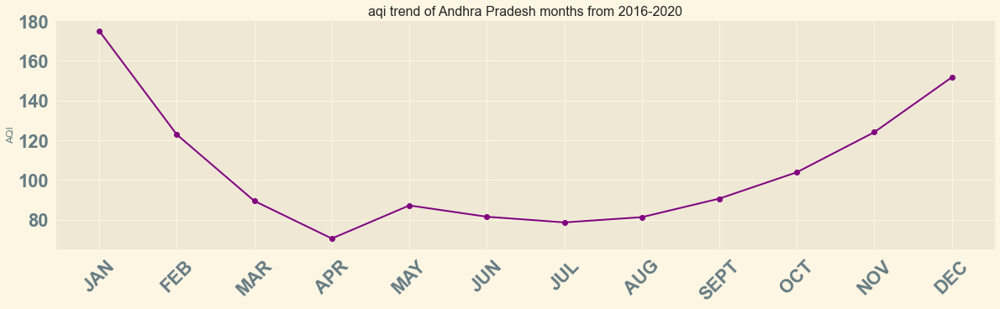

In [33]:
required_state = "Andhra Pradesh"
year_or_month = 1 # 0 for yeqrly report 1 for monthly
state_Aqi_from_2015_to_2020(required_state, year_or_month)

* the highest aqi of all months in jan as BHOGI festival is celebrated in andra pradesh

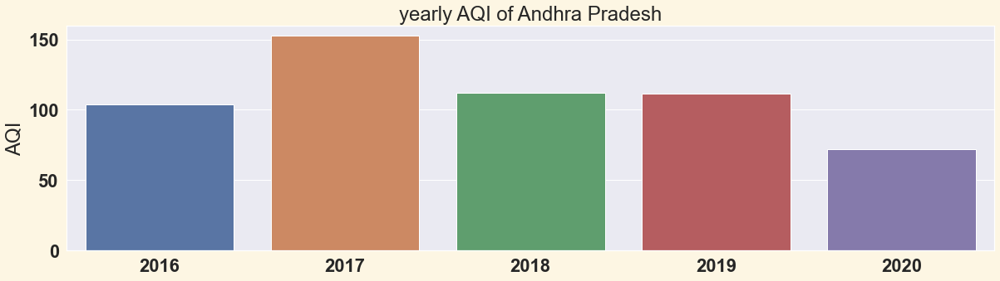

In [34]:
required_state = "Andhra Pradesh"
year_or_month = 0 # 0 for yeqrly report 1 for monthly
state_Aqi_from_2015_to_2020(required_state, year_or_month)

* highest aqi in 2017 with 2020 being the least toxic

### You can put other states instead of andra pradesh and check aqi reports of all states

In [35]:
# -------------------------------------------------------------------------------------------------------------------
# 5. Yearly/ monthly city_Aqi_from_2015_to_2020 function

# Chennai

def city_Aqi_from_2015_to_2020(required_city, year_or_month): # 1, 2

    '''
        This function shows the aqi trend of a city from 2016 to 2020 on a yearly or monthly basis

        steps:
        1. checks if year_or_month is 0 or 1 on these basis it shows the monthly aqi trend or yearly aqi trend
        2. gets the required city from the user
        3. makes mask and then makes required_city_df
        4. if 0 years_group is the mean() of all aqi readings from 2016 to 2020 else its all months from 2016 to 2020
        5. makes the bar/line plot
    '''

    if year_or_month == 0: # yearly aqi report

        required_city_mask = station_merged_df["City"] == required_city # 3
        required_city_df = station_merged_df[required_city_mask] # 3
        years_group = pd.DataFrame(required_city_df.groupby("year")["AQI"].mean()).reset_index() # 4
        mpl.style.use("Solarize_Light2")  # 5
        plt.figure(figsize=(20,5)) # 5
        sns.set(font_scale=2) # 5
        sns.barplot(x="year", y="AQI", data=years_group).set(title=f"yearly AQI of {required_city}", xlabel="", ylabel="AQI") # 5

    elif year_or_month == 1: # monthly report

        required_city_mask = station_merged_df["City"] == required_city # 3
        required_city_df = station_merged_df[required_city_mask] # 3
        months_group = pd.DataFrame(required_city_df.groupby("month")["AQI"].mean()).reset_index() # 4
        mpl.style.use("Solarize_Light2") # 5
        plt.figure(figsize=(20,5)) # 5
        plt.xticks(rotation=45)
        plt.plot(["JAN", "FEB", "MAR", "APR", "MAY", "JUN", "JUL", "AUG", "SEPT", "OCT","NOV", "DEC"], months_group["AQI"], marker="o", c="purple") # 5
        plt.title(f"aqi trend of {required_city} months from 2016-2020")
        plt.ylabel("AQI")

In [36]:
city_list = station_merged_df.City.unique()
print("The number of cities avaible are: ", len(city_list))
print()
print(city_list)
print("\n --- JUST COPY PASTE THE CITY YOU WANNA SEE AQI GRAPH OF IN THE CODE BELOW --- ")

The number of cities avaible are:  26

['Amaravati' 'Visakhapatnam' 'Guwahati' 'Patna' 'Chandigarh' 'Delhi'
 'Ahmedabad' 'Gurugram' 'Jorapokhar' 'Bengaluru' 'Ernakulam' 'Kochi'
 'Thiruvananthapuram' 'Bhopal' 'Mumbai' 'Shillong' 'Aizawl' 'Brajrajnagar'
 'Talcher' 'Amritsar' 'Jaipur' 'Chennai' 'Coimbatore' 'Hyderabad'
 'Lucknow' 'Kolkata']

 --- JUST COPY PASTE THE CITY YOU WANNA SEE AQI GRAPH OF IN THE CODE BELOW --- 


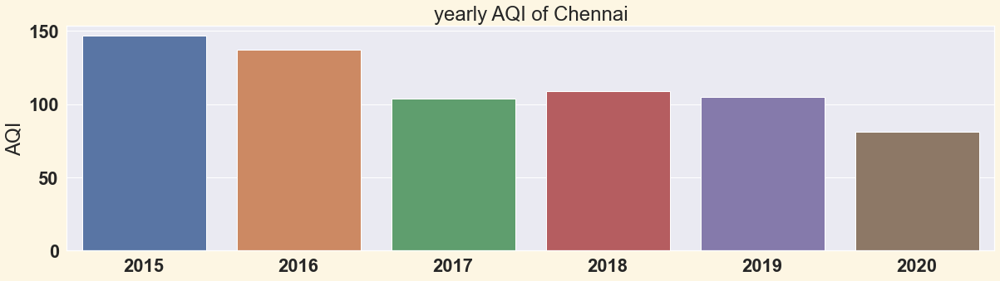

In [37]:
required_city = "Chennai"
year_or_month = 0 # 0 for yeqrly report 1 for monthly
city_Aqi_from_2015_to_2020(required_city, year_or_month)

* the aqi index of chennai has been steadily decreasing throughout the years

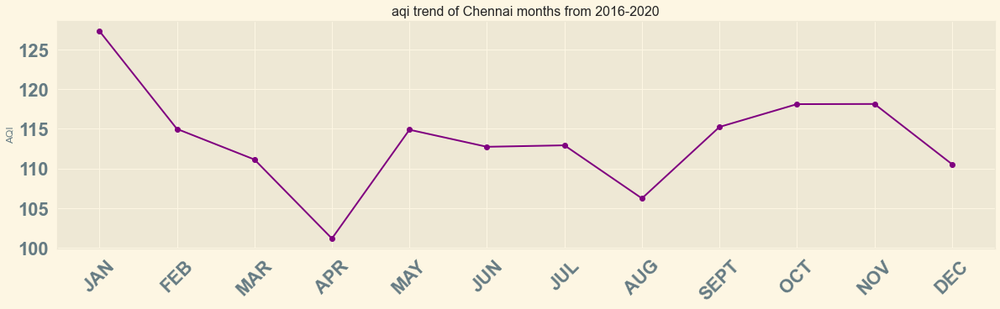

In [38]:
required_city = "Chennai"
year_or_month = 1 # 0 for yeqrly report 1 for monthly
city_Aqi_from_2015_to_2020(required_city, year_or_month)

* jan seems to be the most toxic month for chennai as well

### You can put other cities instead of chennai and check aqi reports of all Cities

### Why only top 3 gasses?
* there are in total of 11 gasses that affect the aqi of an area showing all 11 on a barplot will be very messy so i will be showing only the top 3 contributor gasses which affect the aqi

In [39]:
# -------------------------------------------------------------------------------------------------------------------
# 6. correlation of toxic gasses with aqi (top 3)

correlation_table = station_day_df.corr()
correlation_table

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
PM2.5,1.000000,0.858750,0.476948,0.445639,0.470342,0.428569,0.094220,0.195771,0.133021,0.118491,0.291305,0.080884,0.814845
PM10,0.858750,1.000000,0.512584,0.487891,0.521199,0.484385,0.216346,0.277418,0.044404,0.110385,0.333021,0.043179,0.885070
NO,0.476948,0.512584,1.000000,0.577518,0.865261,0.332881,0.123918,0.190461,0.019317,0.148848,0.280558,0.050431,0.476714
NO2,0.445639,0.487891,0.577518,1.000000,0.721196,0.388384,0.176172,0.289192,0.223971,0.118302,0.302385,0.217948,0.499207
NOx,0.470342,0.521199,0.865261,0.721196,1.000000,0.348228,0.130189,0.230971,0.101440,0.156820,0.269347,0.093530,0.498363
NH3,0.428569,0.484385,0.332881,0.388384,0.348228,1.000000,0.179387,0.110722,0.126337,0.051289,0.233280,0.020078,0.440643
CO,0.094220,0.216346,0.123918,0.176172,0.130189,0.179387,1.000000,0.371101,0.009479,0.052970,0.110304,0.123554,0.448148
SO2,0.195771,0.277418,0.190461,0.289192,0.230971,0.110722,0.371101,1.000000,0.134844,0.057793,0.211878,0.213387,0.393349
O3,0.133021,0.044404,0.019317,0.223971,0.101440,0.126337,0.009479,0.134844,1.000000,0.000773,0.079344,0.072972,0.175122
Benzene,0.118491,0.110385,0.148848,0.118302,0.156820,0.051289,0.052970,0.057793,0.000773,1.000000,0.496211,0.225983,0.116805


<AxesSubplot:>

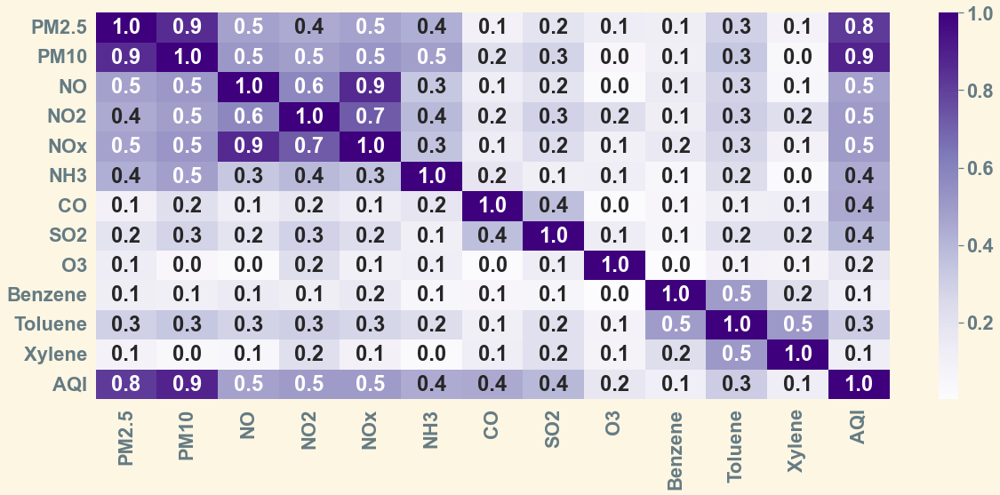

In [40]:
plt.figure(figsize=(20,8))
sns.heatmap(correlation_table, annot=True, fmt=".1f" , cmap="Purples")

* so from the above heatmap we see the best 3 gasses are as follows
* PM10 > PM2.5 > NO2 | 0.8 > 0.9 > 0.5 respectively
* so i will be plotting their mean values throughout the months and years of avaible states and citites in india

In [41]:
# -------------------------------------------------------------------------------------------------------------------
# 7. yearly/monthly state_toxic_gas_from_2015_2020 india function

def state_toxic_gas_from_2015_2020(required_state, year_or_month): # 1
    
    '''
        this function shows the trend of PM10, PM2.5, NO2 in a state from 2015-2020

        steps:

        1. get the year_or_month and required_state from the user
        2. make a yearly trend report if 0 or a monthly trend report if 1
        3. extract the states rows from the df and remove all unwanted columns
        4. now from this df get the years/months for labels and extract mean values of all three pollutants from 2016-2020 in state
        5. make the multiple bar graph by setting up tick locations and putting values extracted above
    '''

    if year_or_month == 0: # 2

        required_state_mask = station_merged_df["State"] == required_state # 3 
        required_state_df = station_merged_df[required_state_mask] # 3 
        required_state_df = required_state_df[['PM2.5', 'PM10','NO2','AQI','year']] # 3

        year_group = required_state_df.groupby("year") # 4
        years = list(str(year) for year in year_group.groups.keys()) # 4
        state_PM10 = required_state_df.groupby("year")['PM10'].mean() # 4
        state_PM25 = required_state_df.groupby("year")['PM2.5'].mean() # 4
        state_NO2 = required_state_df.groupby("year")['NO2'].mean() # 4

        mpl.style.use("Solarize_Light2")  # 5 
        plt.figure(figsize=(20,7)) # 5 

        pm10_ticks = range(1, len(years)+1) # 5 
        pm25_ticks = [x+0.2 for x in pm10_ticks] # 5 
        NO2_ticks = [x-0.2 for x in pm10_ticks] # 5 

        plt.bar(pm10_ticks, state_PM10, width=0.2, label="PM10") # 5 
        plt.bar(pm25_ticks,state_PM25, width=0.2, label="PM2.5") # 5 
        plt.bar(NO2_ticks,state_NO2, width=0.2, label="NO2") # 5 

        plt.title(f'Pollution levels in {required_state}') # 5 
        plt.ylabel('Pollutant levels (in thier respective units)', fontsize=20) # 5 
        plt.xticks(pm10_ticks, years) # 5 
        plt.legend() # 5 
        plt.show() # 5 

    elif year_or_month == 1: # 2
        
        required_state_mask = station_merged_df["State"] == required_state # 3 
        required_state_df = station_merged_df[required_state_mask] # 3 
        required_state_df = required_state_df[['PM2.5', 'PM10','NO2','AQI','month']] # 3

        state_PM10 = list(required_state_df.groupby("month")['PM10'].mean()) # 4
        state_PM25 = list(required_state_df.groupby("month")['PM2.5'].mean()) # 4
        state_NO2 = list(required_state_df.groupby("month")['NO2'].mean()) # 4

        mpl.style.use("Solarize_Light2")  # 5 
        plt.figure(figsize=(20,7)) # 5 

        pm10_ticks = range(1, len(state_PM10)+ 1) # 5 
        pm25_ticks = [x+0.2 for x in pm10_ticks] # 5 
        NO2_ticks = [x-0.2 for x in pm10_ticks] # 5 

        plt.bar(pm10_ticks, state_PM10, width=0.2, label="PM10") # 5 
        plt.bar(pm25_ticks,state_PM25, width=0.2, label="PM2.5") # 5 
        plt.bar(NO2_ticks,state_NO2, width=0.2, label="NO2") # 5 
        plt.title(f'Pollution levels in {required_state}') # 5 
        plt.ylabel('Pollutant levels (in thier respective units)', fontsize=20) # 5 

        if len(pm10_ticks) == 12:
            plt.xticks(pm10_ticks, ["JAN", "FEB", "MAR", "APR", "MAY", "JUN", "JUL", "AUG", "SEPT", "OCT", "NOV", "DEC"]) # 5 
        elif len(pm10_ticks) != 12:
            plt.xticks(pm10_ticks, ["JAN", "FEB", "MAR", "APR", "MAY", "JUN", "JUL", "SEPT", "OCT", "NOV", "DEC"])
            
        plt.legend() # 5 
        plt.show() # 5


In [42]:
state_list = station_merged_df.State.unique()
print("The number of states avaible are: ", len(state_list))
print()
print(state_list)
print("\n --- JUST COPY PASTE THE STATE YOU WANNA SEE TOXIC GAS GRAPH OF IN THE CODE BELOW --- ")

The number of states avaible are:  21

['Andhra Pradesh' 'Assam' 'Bihar' 'Chandigarh' 'Delhi' 'Gujarat' 'Haryana'
 'Jharkhand' 'Karnataka' 'Kerala' 'Madhya Pradesh' 'Maharashtra'
 'Meghalaya' 'Mizoram' 'Odisha' 'Punjab' 'Rajasthan' 'Tamil Nadu'
 'Telangana' 'Uttar Pradesh' 'West Bengal']

 --- JUST COPY PASTE THE STATE YOU WANNA SEE TOXIC GAS GRAPH OF IN THE CODE BELOW --- 


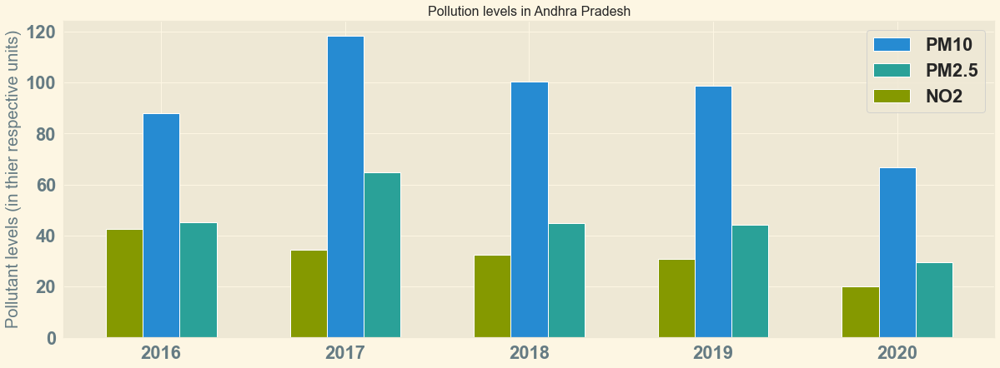

In [43]:
required_state = 'Andhra Pradesh'
year_or_month = 0
state_toxic_gas_from_2015_2020(required_state, year_or_month)


* if you see the yearly aqi graph of andra pradesh 2017 had the highest aqi
* in our yearly toxic gass graph of andra pradesh 2017 has the highest values of these gasses
* this proves the high corellation of these 3 gasses with aqi 

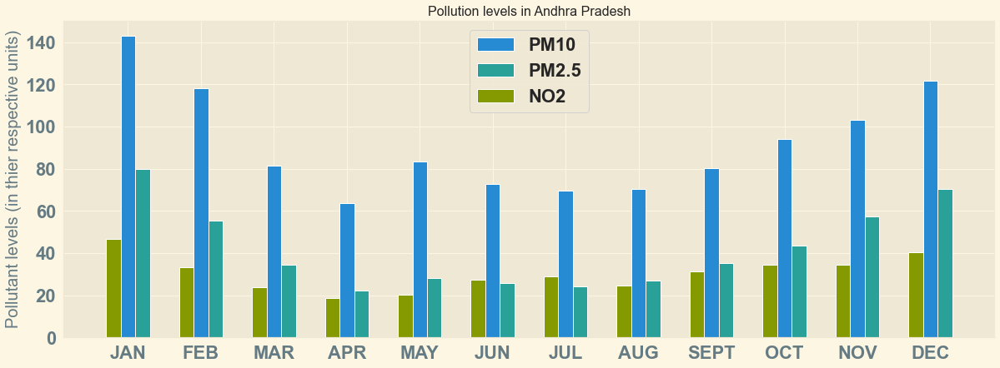

In [44]:
required_state = 'Andhra Pradesh'
year_or_month = 1
state_toxic_gas_from_2015_2020(required_state, year_or_month)

* the similar pattern can be seen in the monthly aqi graph of andrapradesh jan and dec peaked with the graph almost forming a u shape
* the monthly toxic gass graph of andra pradesh shows the same u shape with the aqi peaks in jan and dec 
* this proves the high correlation between these 3 gasses and aqi 

In [45]:
# -------------------------------------------------------------------------------------------------------------------
# 7. yearly/monthly city_toxic_gas_from_2015_2020 india function

def city_toxic_gas_from_2015_2020(required_city, year_or_month): # 1
    
    '''
        this function shows the trend of PM10, PM2.5, NO2 in a city from 2015-2020

        steps:

        1. get the year_or_month and required_state from the user
        2. make a yearly trend report if 0 or a monthly trend report if 1
        3. extract the cities rows from the df and remove all unwanted columns
        4. now from this df get the years/months for labels and extract mean values of all three pollutants from 2016-2020 in city
        5. make the multiple bar graph by setting up tick locations and putting values extracted above
    '''

    if year_or_month == 0: # 2

        required_city_mask = station_merged_df["City"] == required_city # 3 
        required_city_df = station_merged_df[required_city_mask] # 3 
        required_city_df = required_city_df[['PM2.5', 'PM10','NO2','AQI','year']] # 3

        year_group = required_city_df.groupby("year") # 4
        years = list(str(year) for year in year_group.groups.keys()) # 4
        city_PM10 = required_city_df.groupby("year")['PM10'].mean() # 4
        city_PM25 = required_city_df.groupby("year")['PM2.5'].mean() # 4
        city_NO2 = required_city_df.groupby("year")['NO2'].mean() # 4

        mpl.style.use("Solarize_Light2")  # 5 
        plt.figure(figsize=(20,7)) # 5 

        pm10_ticks = range(1, len(years)+1) # 5 
        pm25_ticks = [x+0.2 for x in pm10_ticks] # 5 
        NO2_ticks = [x-0.2 for x in pm10_ticks] # 5 

        plt.bar(pm10_ticks, city_PM10, width=0.2, label="PM10") # 5 
        plt.bar(pm25_ticks,city_PM25, width=0.2, label="PM2.5") # 5 
        plt.bar(NO2_ticks,city_NO2, width=0.2, label="NO2") # 5 

        plt.title(f'Pollution levels in {required_city}') # 5 
        plt.ylabel('Pollutant levels (in thier respective units)', fontsize=20) # 5 
        plt.xticks(pm10_ticks, years) # 5 
        plt.legend() # 5 
        plt.show() # 5 

    elif year_or_month == 1: # 2
        
        required_city_mask = station_merged_df["City"] == required_city # 3 
        required_city_df = station_merged_df[required_city_mask] # 3 
        required_city_df = required_city_df[['PM2.5', 'PM10','NO2','AQI','month']] # 3

        city_PM10 = list(required_city_df.groupby("month")['PM10'].mean()) # 4
        city_PM25 = list(required_city_df.groupby("month")['PM2.5'].mean()) # 4
        city_NO2 = list(required_city_df.groupby("month")['NO2'].mean()) # 4

        mpl.style.use("Solarize_Light2")  # 5 
        plt.figure(figsize=(20,7)) # 5 

        pm10_ticks = range(1, len(city_PM10)+ 1) # 5 
        pm25_ticks = [x+0.2 for x in pm10_ticks] # 5 
        NO2_ticks = [x-0.2 for x in pm10_ticks] # 5 

        plt.bar(pm10_ticks, city_PM10, width=0.2, label="PM10") # 5 
        plt.bar(pm25_ticks,city_PM25, width=0.2, label="PM2.5") # 5 
        plt.bar(NO2_ticks,city_NO2, width=0.2, label="NO2") # 5 
        plt.title(f'Pollution levels in {required_city}') # 5 
        plt.ylabel('Pollutant levels (in thier respective units)', fontsize=20) # 5 

        if len(pm10_ticks) == 12:
            plt.xticks(pm10_ticks, ["JAN", "FEB", "MAR", "APR", "MAY", "JUN", "JUL", "AUG", "SEPT", "OCT", "NOV", "DEC"]) # 5 
        elif len(pm10_ticks) != 12:
            plt.xticks(pm10_ticks, ["JAN", "FEB", "MAR", "APR", "MAY", "JUN", "JUL", "SEPT", "OCT", "NOV", "DEC"])
            
        plt.legend() # 5 
        plt.show() # 5

In [46]:
city_list = station_merged_df.City.unique()
print("The number of cities avaible are: ", len(city_list))
print()
print(city_list)
print("\n --- JUST COPY PASTE THE CITY YOU WANNA SEE AQI GRAPH OF IN THE CODE BELOW --- ")

The number of cities avaible are:  26

['Amaravati' 'Visakhapatnam' 'Guwahati' 'Patna' 'Chandigarh' 'Delhi'
 'Ahmedabad' 'Gurugram' 'Jorapokhar' 'Bengaluru' 'Ernakulam' 'Kochi'
 'Thiruvananthapuram' 'Bhopal' 'Mumbai' 'Shillong' 'Aizawl' 'Brajrajnagar'
 'Talcher' 'Amritsar' 'Jaipur' 'Chennai' 'Coimbatore' 'Hyderabad'
 'Lucknow' 'Kolkata']

 --- JUST COPY PASTE THE CITY YOU WANNA SEE AQI GRAPH OF IN THE CODE BELOW --- 


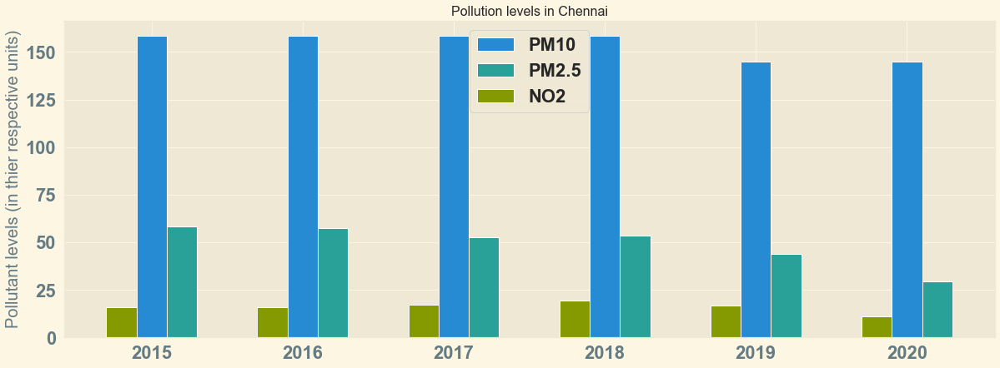

In [47]:
required_city = "Chennai"
year_or_month = 0
city_toxic_gas_from_2015_2020(required_city, year_or_month)

* if you check the aqi of chennai on the code above it shows a similar trend of it decreasing steadily over time
* this proves that the correlation of gasses with aqi is strong even on a city level
* lets check the monthly toxic gas trend in channai 

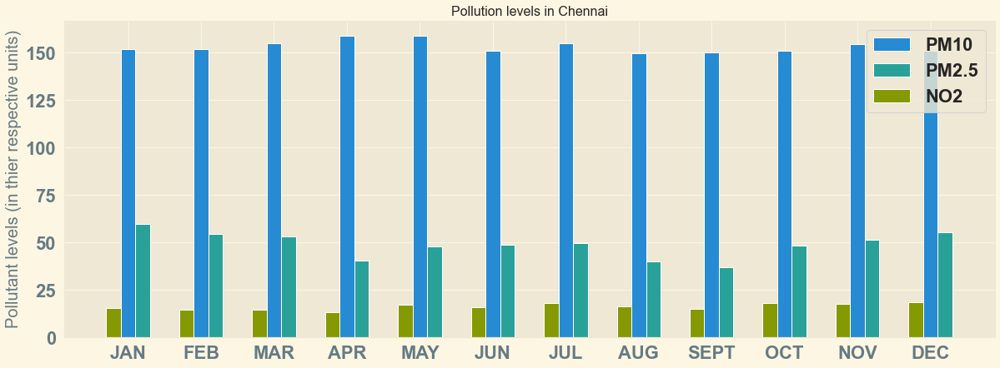

In [48]:
required_city = "Chennai"
year_or_month = 1
city_toxic_gas_from_2015_2020(required_city, year_or_month)

* also a similar trend to monthly aqi of channai 

### both the yearly and monthly reports are avaible for all cities and states mentioned in this code simply copy paste them

### by this analysis we can conclude that aqi of a city/ state highly depends on PM10, PM2.5, NO2 levels in the air more insights are stated above

### finnaly lets conclude this notebook by showing the sates of these of states/cities on an indian map

In [49]:

# -------------------------------------------------------------------------------------------------------------------
# 9. aqi of states on an india map

sates_geo_data =  gpd.read_file("F://aryans_code_notes//machine_learning//AQI_predictior//indian_sates.json")
# sates_geo_data.head(2)

In [50]:
india_state_map = folium.Map(location=[22.5937, 78.9629], zoom_start=5)

In [51]:
india_state_map.choropleth(
    geo_data=sates_geo_data,
    data=station_merged_df,
    columns=['State', 'AQI'],
    key_on='feature.properties.NAME_1',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='AIR QUALITY INDEX OF SATES IN INDIA '
)

india_state_map

* From the map above the norhtern india seems to be the most poulated 
* while jammu and kashmir and eastern southern and central india seem to be doing good

In [54]:
# -------------------------------------------------------------------------------------------------------------------
# 9. aqi of cities on an india map

cities_geo_data =  gpd.read_file("F://aryans_code_notes//machine_learning//AQI_predictior//india_district.geojson")

In [55]:
india_city_map = folium.Map(location=[22.5937, 78.9629], zoom_start=5)

india_city_map.choropleth(
    geo_data=cities_geo_data,
    data=station_merged_df,
    columns=['City', 'AQI'],
    key_on='feature.properties.NAME_1',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.7,
    legend_name='AIR QUALITY INDEX OF CITIES IN INDIA '
)
india_city_map


* online avaible json files only have data on chandighar and delhi which is why these are the only coloured ones
* other cities have HIGH aqi but it wont show on this map as there data isnt avaible in the json file

### take this map with a grain of salt the information above is misleading as some cities with higher aqi are lighter

# this is it for preliminary and exploratory analysis of station merged df 
# ________________________________________________________________________________________________________________________

# made by Aryan rathore (cse core student at vit bhopal)
# email :- Aryanrathore13572002@gmail.com
# linkedin :- https://www.linkedin.com/in/aryan-rathore-b15459215/
# github :- https://github.com/aryanrathore1012
# ________________________________________________________________________________